# Data loader example
## Import necessary libraries

In [1]:
import os
import coloredlogs, logging
import scipy.io
import pandas as pd
import matplotlib.pyplot as plt

try:
    import example_code.helper_functions as h
except:
    import helper_functions as h

## Constants
* Change the ```OUTPUT_FOLDER``` path to the folder containing the RIRs.
* Change the ```JSON_FILENAME``` to your desired metadata file. It's searched for in the ```OUTPUT_FOLDER```.
* The ```MATLAB_FILENAME``` contains additional information about the simulation. Here the first simulation run can be chosen. It's searched for in the ```OUTPUT_FOLDER```.
* Change the ```MODEL_3D``` to the one you selected as a database.

In [2]:
# Folder where the Database is saved (Folder "OUT" needs to be selected)
OUTPUT_FOLDER = '../database/OUT'
OUTPUT_FOLDER = "/mnt/nfs/Databases/ASN_Database_Custom_3.1_sorted/OUT"
# Name of the metadata JSON file
JSON_FILENAME = 'RIR.json'
# Name of one simulation scenario data file (there are multiple)
MATLAB_FILENAME = 'RIR_1.MAT'
# Name of logging file to be generated
LOG_FOLDER = 'output'
LOG_FILE = f"{LOG_FOLDER}/log.txt"
# Path to 3D model (as STI) to use for plotting
MODEL_3D = 'other/3D_Models/ASN_empty.stl' # Use if room model chosen without humans
# MODEL_3D = 'other/3D_Models/ASN_humans.stl' # Use if room model chosen with humans
# Target sample rate signals are resampled to
FS = 16000
# Clean audio file for convolution
CLEAN_AUDIO = 'other/audio/speech.wav'

In [3]:
if h.isnotebook():
    example_folder = os.path.dirname(os.path.abspath("__file__"))
    MODEL_3D = os.path.abspath(os.path.join(example_folder, f"../{MODEL_3D}"))
    CLEAN_AUDIO = os.path.abspath(os.path.join(example_folder, f"../{CLEAN_AUDIO}"))

## Inits
Initializes logging and torchaudio for the WAV dataloader.

In [4]:
os.makedirs(LOG_FOLDER, exist_ok=True)

# Init Config
logging.basicConfig(
    level=logging.DEBUG,
    handlers=[
        logging.FileHandler(LOG_FILE),
        logging.StreamHandler()
    ])
logger = logging.getLogger(__name__)
coloredlogs.install(level='INFO', logger=logger, fmt='%(levelname)-8s %(message)s')

## Load JSON containing meta information

In [5]:
# To path
OUTPUT_FOLDER = os.path.abspath(OUTPUT_FOLDER)
logger.info('Loading database: ' + str(OUTPUT_FOLDER))

# Load JSON file
meta_data = h.get_json_data(OUTPUT_FOLDER, JSON_FILENAME)

INFO     Loading database: /mnt/nfs/Databases/ASN_Database_Custom_3.1_sorted/OUT


### Create node array
This part converts the metadata information, which contains one entry for each RIR, to a sorted dictionary.
Each entry in the dictionary contains all information for one node including the source information as well.

In [6]:
# Creates dictionary for each node in database from source pair information.

nodes = h.get_nodes(meta_data, OUTPUT_FOLDER)

  0%|          | 0/5 [00:00<?, ?it/s]

### Number of sources and receivers

In [7]:
logger.info('Number Receiver: ' + str(len(nodes)))
logger.info('Number Sources: ' + str(len(nodes[0]['src'])))

INFO     Number Receiver: 98
INFO     Number Sources: 202


### Load simulation environment information
Some prints of useful information from the simulation is given here.

In [8]:
# This information is created automatically by CATT-Acoustic's TUCT algorithm.
matlab_data_file = os.path.join(OUTPUT_FOLDER, MATLAB_FILENAME)
matlab_data = scipy.io.loadmat(matlab_data_file)

logger.info(f"Room volume: {matlab_data['room_volume'][0][0]}  $m^3$")
logger.info(f"Surface area: {matlab_data['room_surface_area'][0][0]}  $m^2$")
logger.info(f"Sound velocity: {matlab_data['soundvelocity'][0][0]}  $m/s$")
logger.info(f"Air temperature: {matlab_data['air_temperature'][0][0]}  °C")
logger.info(f"Air humidity: {matlab_data['air_humidity'][0][0]}  $\%$")
logger.info(f"Air density: {matlab_data['air_density'][0][0]}  $kg/m^3$")

INFO     Room volume: 103.21296691894531  $m^3$
INFO     Surface area: 285.98431396484375  $m^2$
INFO     Sound velocity: 343.32464599609375  $m/s$
INFO     Air temperature: 20.0  °C
INFO     Air humidity: 50.0  $\%$
INFO     Air density: 1.2000000476837158  $kg/m^3$


## Scenario RIR from one room to another coupled room

## RIR Result

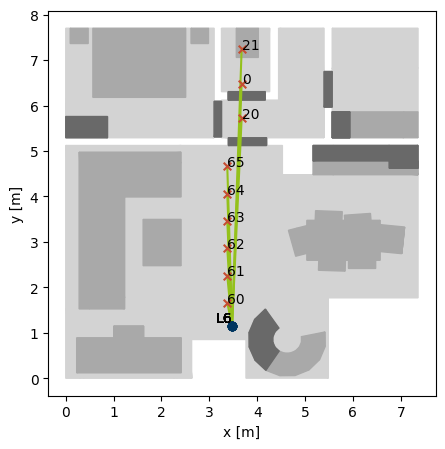

## Separate RIR Results

### RIR 60 - L6

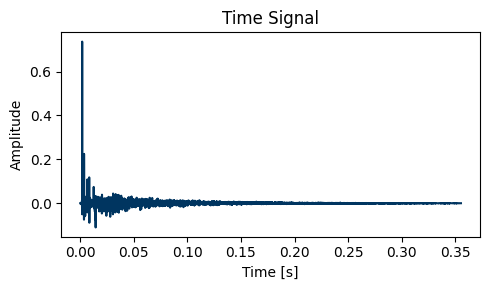

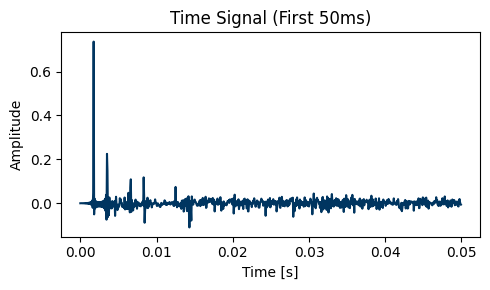

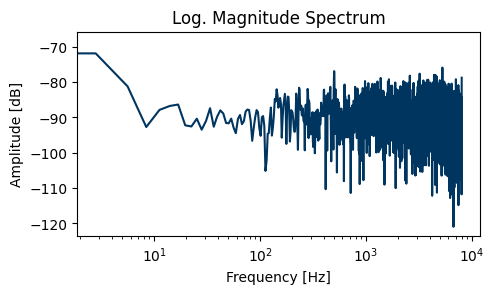

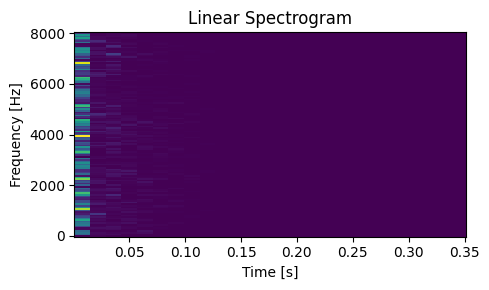

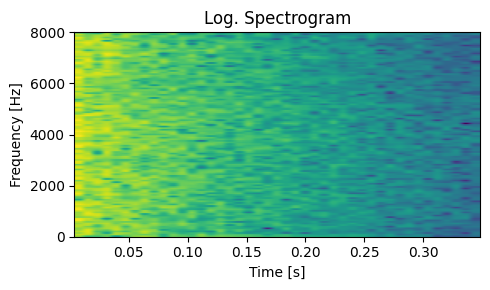

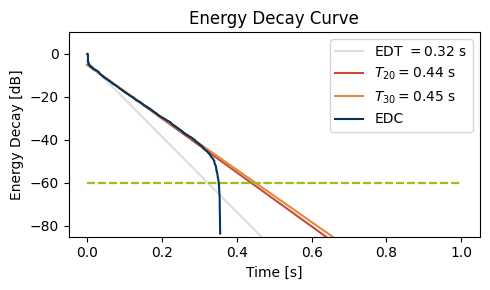

### RIR 61 - L6

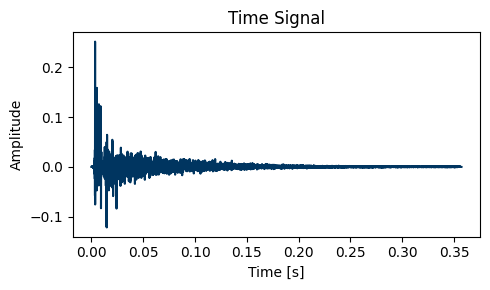

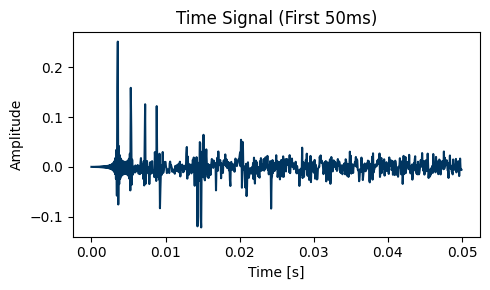

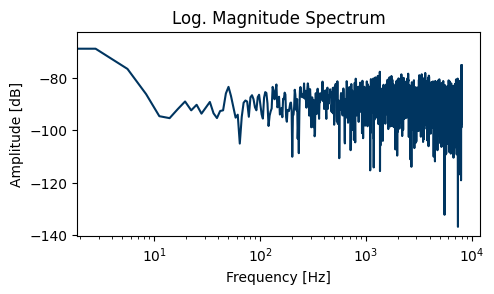

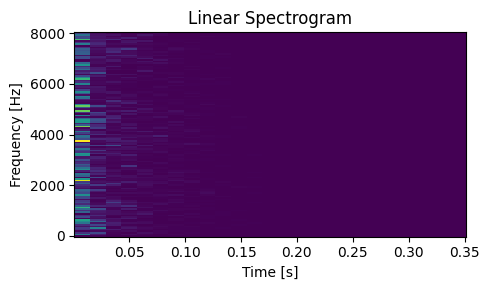

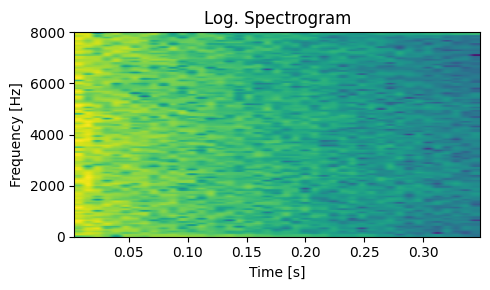

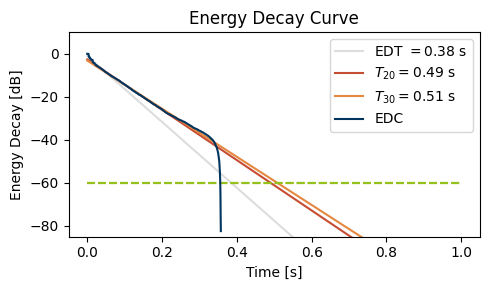

### RIR 62 - L6

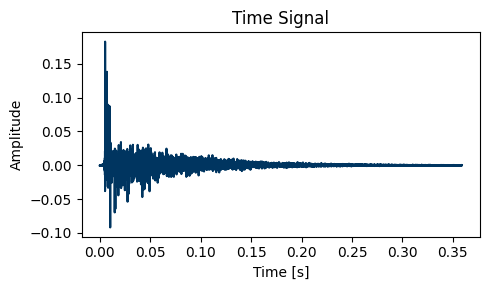

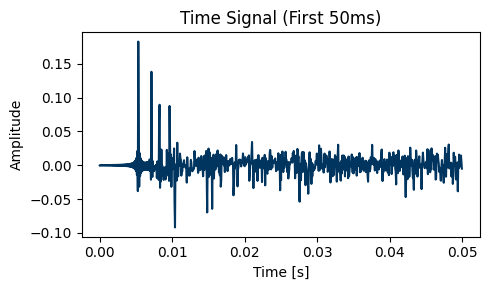

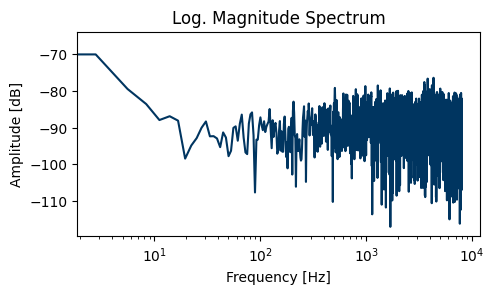

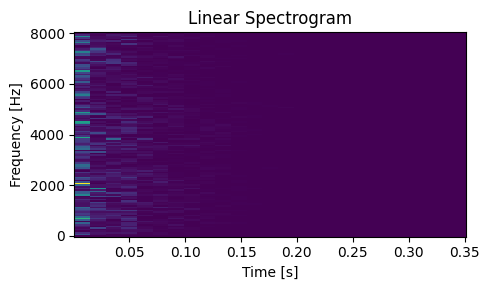

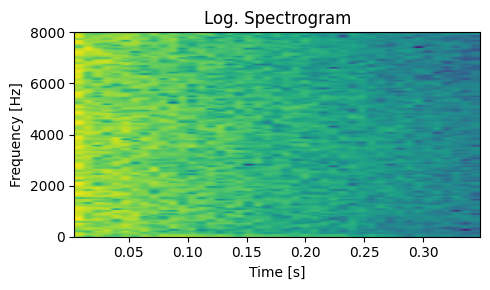

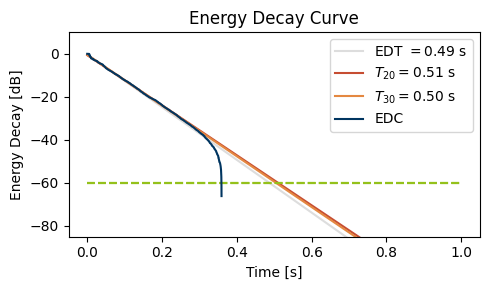

### RIR 63 - L6

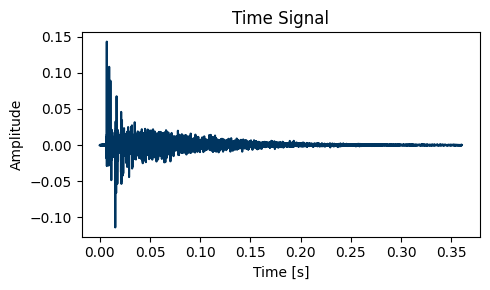

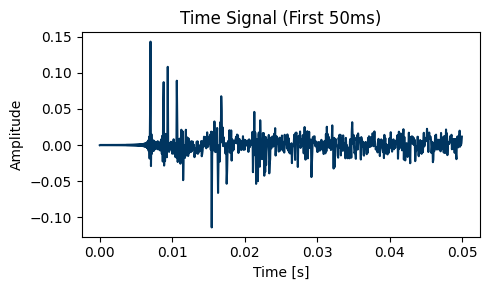

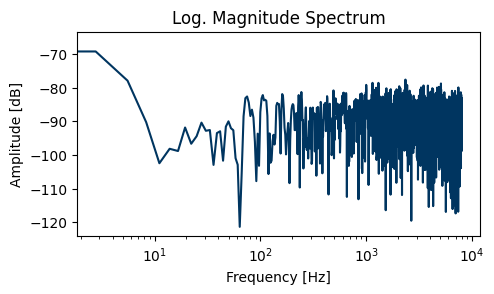

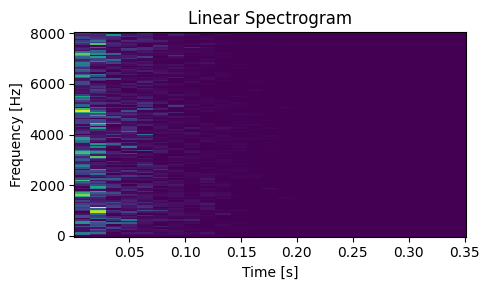

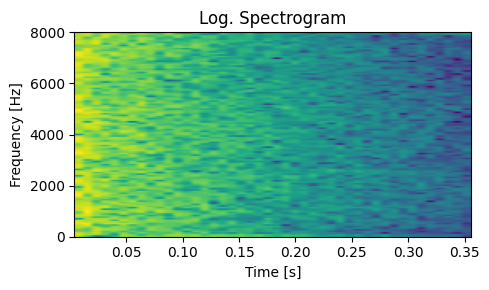

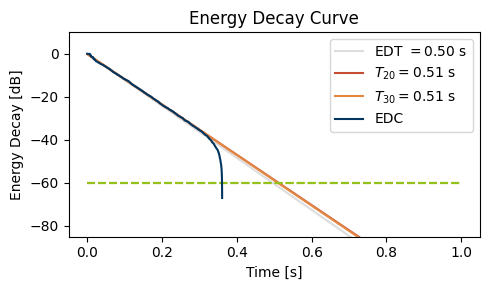

### RIR 64 - L6

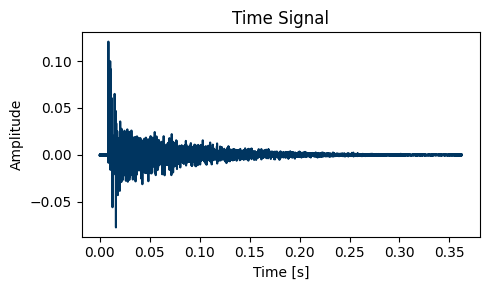

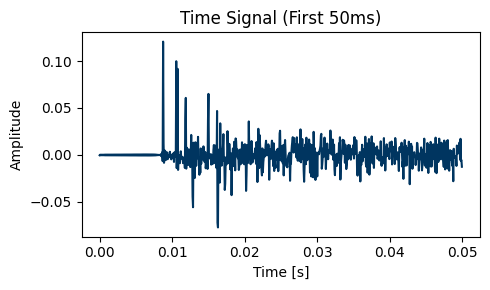

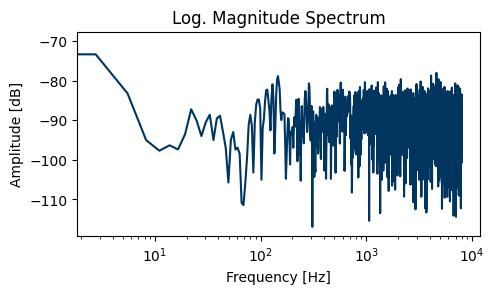

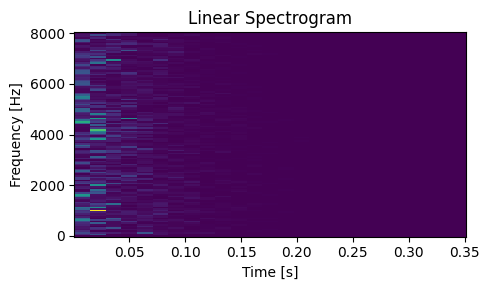

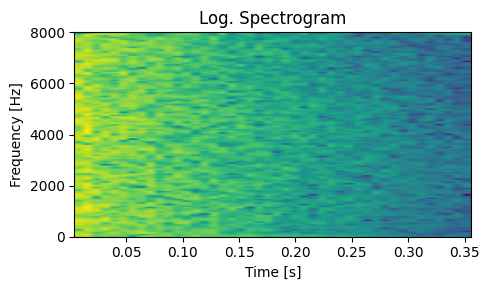

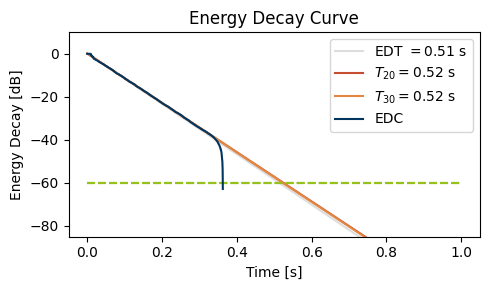

### RIR 65 - L6

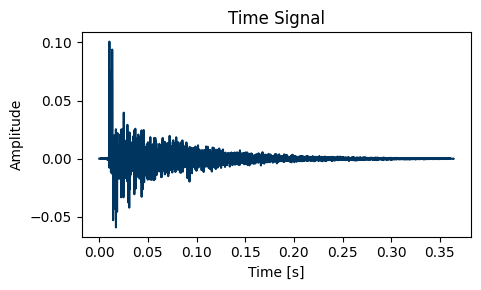

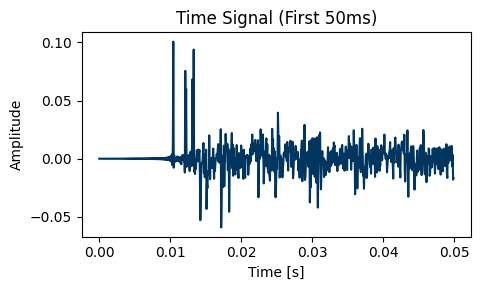

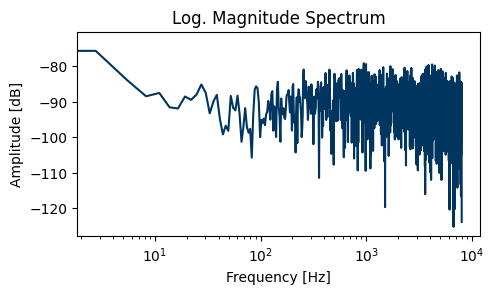

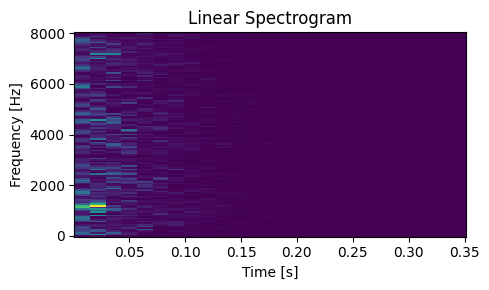

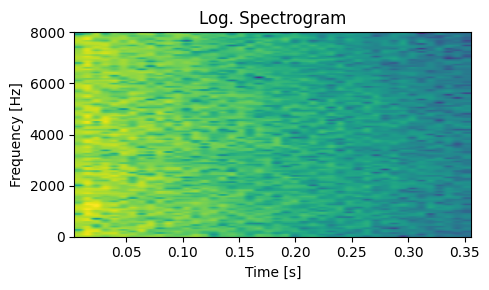

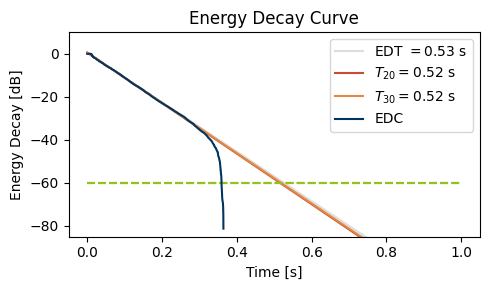

### RIR 20 - L6

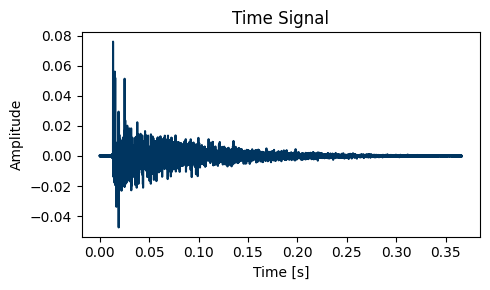

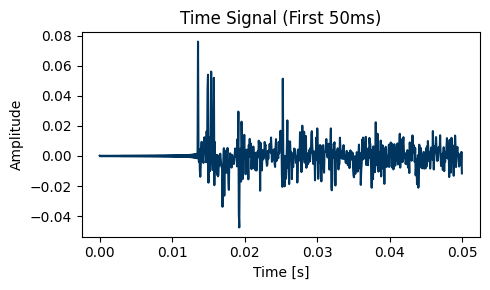

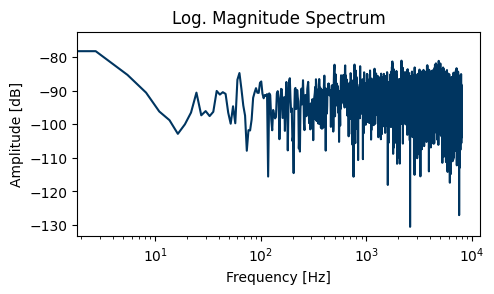

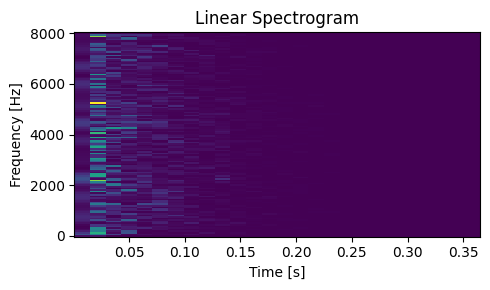

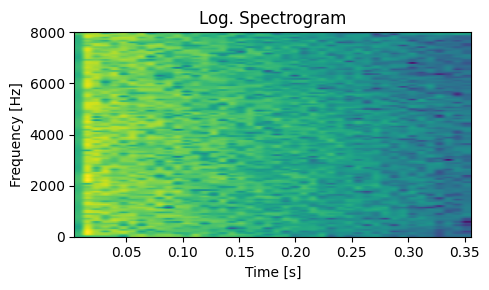

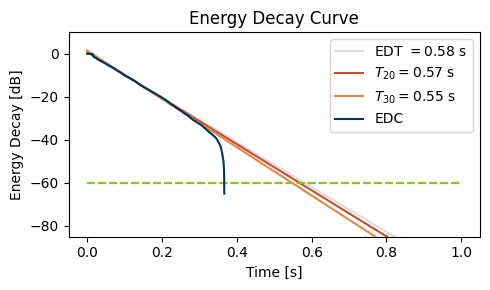

### RIR 0 - L6

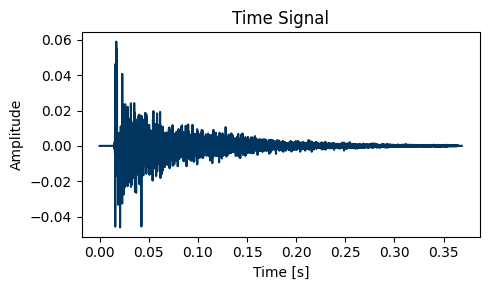

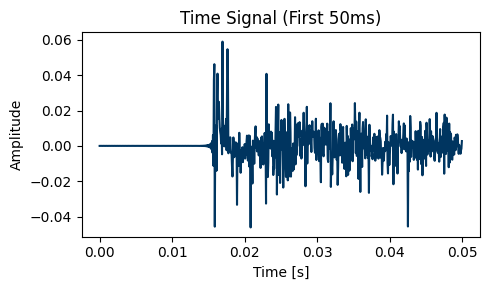

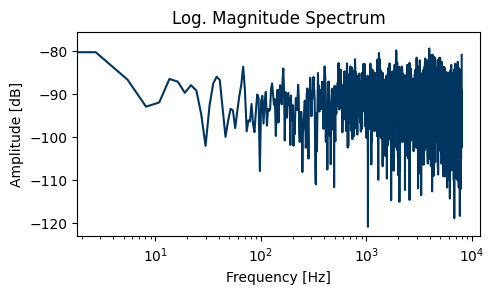

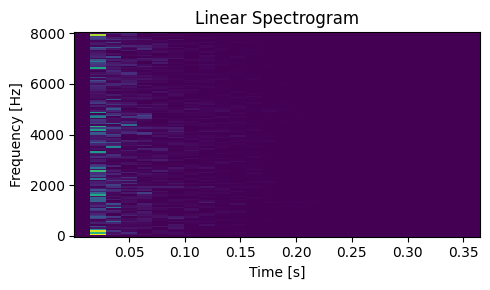

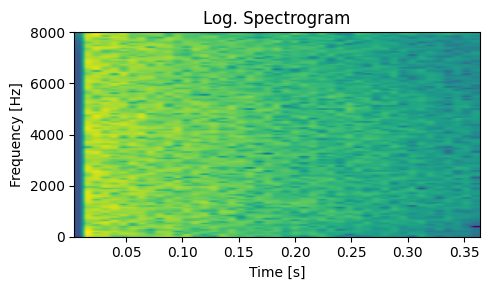

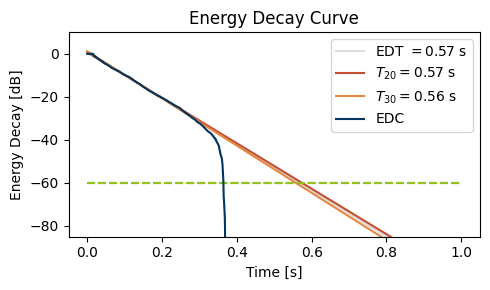

### RIR 21 - L6

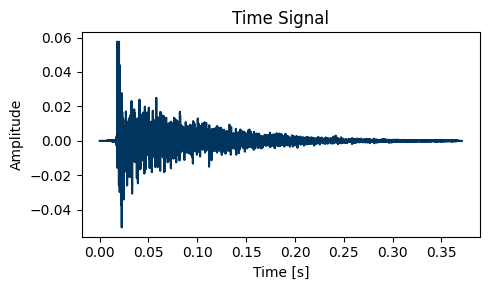

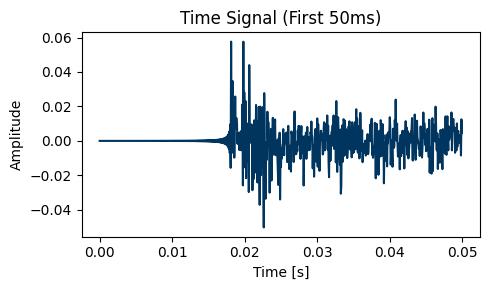

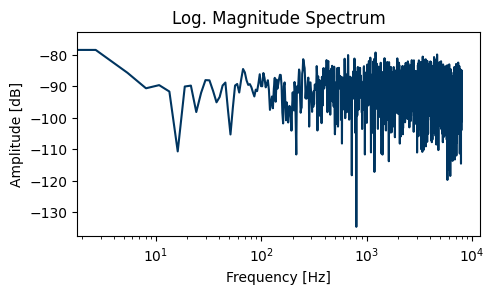

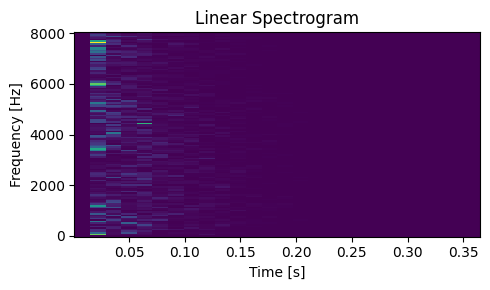

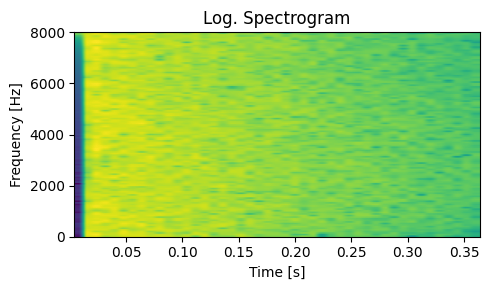

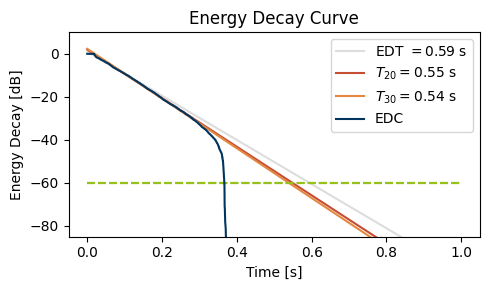

In [9]:
head = ['SINS Mic', 'ASN Node', 'ASN SRC']
df_room = pd.DataFrame(columns=head)

# Living room
asn_nodes = [60, 61, 62, 63, 64, 65, 20, 0, 21]
sins_node = 3
asn_source = 'L6'
for asn_node in asn_nodes:
    df_room = df_room.append({'SINS Mic': sins_node, 'ASN Node': asn_node, 'ASN SRC': asn_source}, ignore_index=True)

fig, ax = h.plot_2d_model(MODEL_3D, figsize=(5,5))
df_room = h.analyze_node_df(
    df=df_room,
    ax=ax,
    fs=FS,
    nodes=nodes,
    directory=f"{LOG_FOLDER}/test",
    clean_audio=CLEAN_AUDIO,
    name='straight_line_rooms',
    plot=True,
    figsize=(5,3)
    )

if h.isnotebook():
    plt.show()
    plt.close()